In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy
import matplotlib.pylab as pylab
import cartopy.feature as cfeature
from endgame import hist2d
import scipy.stats as stats
import xarray as xr
import ipdb
import glob
import itertools
import numpy.ma as ma
from utils import u_statistics as u_stat
from scipy.stats import gaussian_kde
import pickle as pkl
from utils import u_plot as uplot, u_darrays
import pandas as pd
from scipy.stats import gaussian_kde, linregress
import matplotlib.cm as cm
from utils import u_met
import seaborn
import metpy
from metpy import calc
from metpy.units import units
import statsmodels.api as sm
from scipy import ndimage
import matplotlib.patches as patches
import io
import xarray as xr

from numpy.polynomial import polynomial as P

##for regridding, install xesmf:
# conda install esmpy
# pip install xesmf
from utils import constants as cnst

pylab.rcParams['figure.figsize'] = (40., 40.)
%matplotlib inline

In [1]:
cd ..

/home/ck/pythonWorkspace/proj_CEH


In [3]:
import matplotlib.patches as patches
def draw_map(ax, t, lat, lon, title='', levels=None, quiver=None, contour=None, clabel='', cmap='RdBu_r'):
   
    plt.contourf(lon, lat, t, transform=ccrs.PlateCarree(), cmap=cmap, levels=levels, extend='both')
    ax.coastlines()

    ## quiver list
    if quiver is not None:
        qu = ax.quiver(quiver['x'], quiver['y'], quiver['u'], quiver['v'],scale=quiver['scale'],width=0.0005, headwidth=7)
    
    
        ## additional contour on plot   
    if contour is not None:
        contours = ax.contour(contour['x'], contour['y'], contour['data'], levels=contour['levels'], colors='Turquoise', linewidths=0.5 )
        #plt.clabel(contours, inline=True, fontsize=7, fmt='%1.1f')
    
    # Gridlines
    xl = ax.gridlines(draw_labels=True);
    xl.top_labels = False
    xl.right_labels = False
    xl.xlines = False
    xl.ylines=False
    # Countries
    ax.add_feature(cartopy.feature.BORDERS, linestyle='--', color='grey');
    
    #rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=0.8,edgecolor='w',facecolor='none', zorder=99)
        
    #ax.add_patch(rect2)
    
    plt.title(title)
    cbar = plt.colorbar()
    cbar.set_label(clabel)

In [8]:
MREGIONS = {
 'GPlains_N' : [[-100,-90,32,47], 'nam', -6, (1,7), (8,12), (1,12), [-99,-96,42,44], 'GPlains', 'JJA'], # # 18
 'GPlains_S' : [[-100,-90,32,47], 'nam', -6, (1,7), (8,12), (1,12), [-98,-95,36,39], 'GPlains', 'JJA'], # # 18
 'china_W' : [[105,115,25,40], 'asia', 8 , (1,7), (8,12), (1,12), [105,107,29,31], 'china', 'JJA'], # 4
 'china_E' : [[105,115,25,40], 'asia', 8 , (1,7), (8,12), (1,12), [111,113,25,27], 'china', 'JJA'], # 4
 'india_N' : [[70,90, 5,30], 'asia', 5, (1,7), (8,12), (1,12), [74,76,24,26], 'india', 'JJA'], # 7
 'india_S' : [[70,90, 5,30], 'asia', 5, (1,7), (8,12), (1,12), [76,79,18,21], 'india', 'JJA'], # 7
 'WAf_N' : [[-18,25,4,25], 'spac', 0, (1,7), (8,12), (1,12), [-5,5,14,16], 'WAf', 'JJA'], # last is hourly offset to UCT # 12    # [-18,25,4,25]
 'WAf_S' : [[-18,25,4,25], 'spac', 0, (1,7), (8,12), (1,12), [-5,5,7,9], 'WAf', 'JJA'],
 'australia_S' : [[120,140,-27, -15], 'asia', 9, (10,12), (1,5), (1,12), [125,134, -21,-18], 'australia', 'DJF'], # 3
 'australia_N' : [[120,140,-27, -15], 'asia', 9, (10,12), (1,5), (1,12), [125,134, -17,-15], 'australia', 'DJF'],
 'SAf' : [[20,35, -35,-15], 'spac', 2, (9,12), (1,5), (1,12), [21,24.5,-28,-24], 'SAf', 'DJF'], # 10
 'sub_SA_S' : [[-68,-47, -40, -20.5], 'spac', -4, (9,12), (1,5), (1,12), [-63,-60,-33,-30], 'sub_SA', 'DJF'],  # 16
 'sub_SA_N' : [[-68,-47, -40, -20.5], 'spac', -4, (9,12), (1,5), (1,12), [-63,-60,-28,-22], 'sub_SA', 'DJF']  # 16
# 'trop_SA' : [[-75, -50, -20, -5], 'spac', -5, (1,12), (1,12), (1,12)], # 17

}
S_REGION = 'china_W'
REGION = MREGIONS[S_REGION][7]

In [5]:
#era5f_pl = xr.open_mfdataset('/media/ck/LStorage/global_water/ERA5_global_0.7/monthly/pressure_levels/*.nc')
era5f_pl = xr.open_mfdataset(glob.glob('/media/ck/LStorage/global_water/ERA5_global_0.7/monthly/pressure_levels/*.nc')[0:5])
era5f_pl = u_darrays.flip_lat(era5f_pl)

In [6]:
#era5f_pl = xr.open_mfdataset('/media/ck/LStorage/global_water/ERA5_global_0.7/monthly/pressure_levels/*.nc')
era5f_srfc = xr.open_mfdataset(glob.glob('/media/ck/LStorage/global_water/ERA5_global_0.7/monthly/surface/*.nc')[0:5])
era5f_srfc = u_darrays.flip_lat(era5f_srfc)

In [7]:
era5u_mean = (era5f_pl['u'].groupby('time.season')-era5f_pl['u'].groupby('time.season').mean('time')).load()
era5v_mean = (era5f_pl['v'].groupby('time.season')-era5f_pl['v'].groupby('time.season').mean('time')).load()

In [ ]:
era_uh = era5f_pl['u'].sel(level=650).groupby('time.season').mean('time').load()
era_ul = era5f_pl['u'].sel(level=925).groupby('time.season').mean('time').load()
era_vh = era5f_pl['v'].sel(level=650).groupby('time.season').mean('time').load()
era_vl = era5f_pl['v'].sel(level=925).groupby('time.season').mean('time').load()
era_t = era5f_pl['t'].sel(level=925).groupby('time.season').mean('time').load()

era_ushear = era_uh-era_ul
era_vshear = era_vh-era_vl
era_shear = np.sqrt(era_ushear**2+era_vshear**2)

In [91]:
sh = era5f_srfc['sshf'].groupby('time.season').mean('time').load()
t2 = era5f_srfc['t2m'].groupby('time.season').mean('time').load()
lh = era5f_srfc['slhf'].groupby('time.season').mean('time').load()

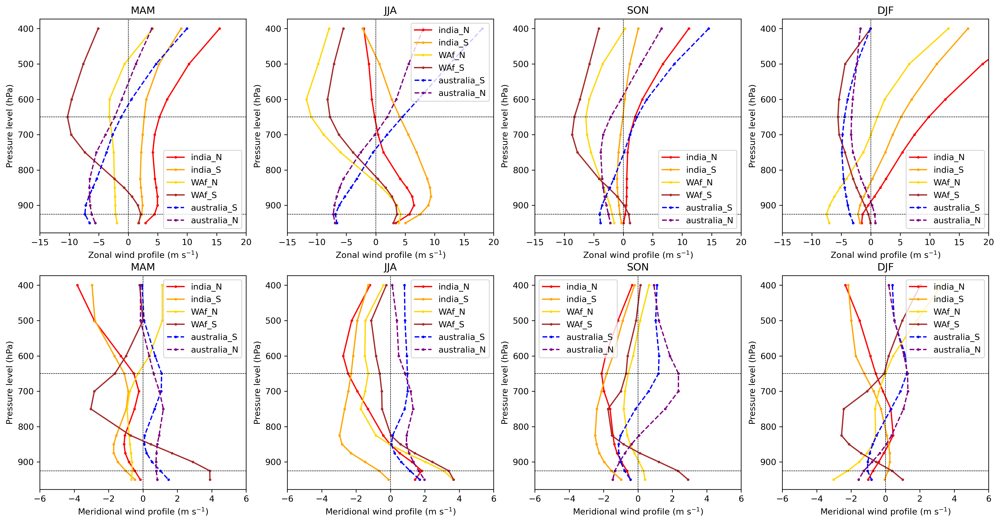

In [34]:
f = plt.figure(figsize=(20,10), dpi=300)

colors = ['red', 'orange', 'gold', 'brown', 'blue', 'purple']
lss = ['solid', 'solid', 'solid', 'solid', 'dashed', 'dashed']


for idx, seas in enumerate(['MAM', 'JJA', 'SON', 'DJF']):
    
    ax = f.add_subplot(2,4,idx+1)
    
    for ids, reg in enumerate(list(MREGIONS.keys())[4:10]):
   
            box = MREGIONS[reg][6]

            era_profile = era5u_mean.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1]), level=slice(350,950)).mean(['longitude','latitude']).squeeze()
         
            ax.plot(era_profile,era_profile.level, label=reg, marker='o', markersize=2, color = colors[ids], linestyle=lss[ids])
            ax.set_xlabel('Zonal wind profile (m s$^{-1}$)')
            ax.set_ylabel('Pressure level (hPa)')
            ax.set_xlim(-15,20)
            plt.title(seas)
            ax.axvline(0, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(925, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(650, linestyle='dashed', color='k', linewidth=0.5)
            
    ax.invert_yaxis()
    plt.legend()
for idx, seas in enumerate(['MAM', 'JJA', 'SON', 'DJF']):
    
    ax = f.add_subplot(2,4,idx+1+4)
    
    for ids, reg in enumerate(list(MREGIONS.keys())[4:10]):
   
            box = MREGIONS[reg][6]

            era_profile = era5v_mean.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1]), level=slice(350,950)).mean(['longitude','latitude']).squeeze()
         
            ax.plot(era_profile,era_profile.level, label=reg, marker='o', markersize=2, color = colors[ids], linestyle=lss[ids])
            ax.set_xlabel('Meridional wind profile (m s$^{-1}$)')
            ax.set_ylabel('Pressure level (hPa)')
            ax.set_xlim(-6,6)
            ax.axvline(0, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(925, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(650, linestyle='dashed', color='k', linewidth=0.5)
            
            plt.title(seas)
            
    ax.invert_yaxis()
    plt.legend()
plt.show()
f.savefig(cnst.FIGS+'/LMCS/ERA5_shear_profiles/MeanEasterlyMCS_ERA5wind_absProfile.jpg')

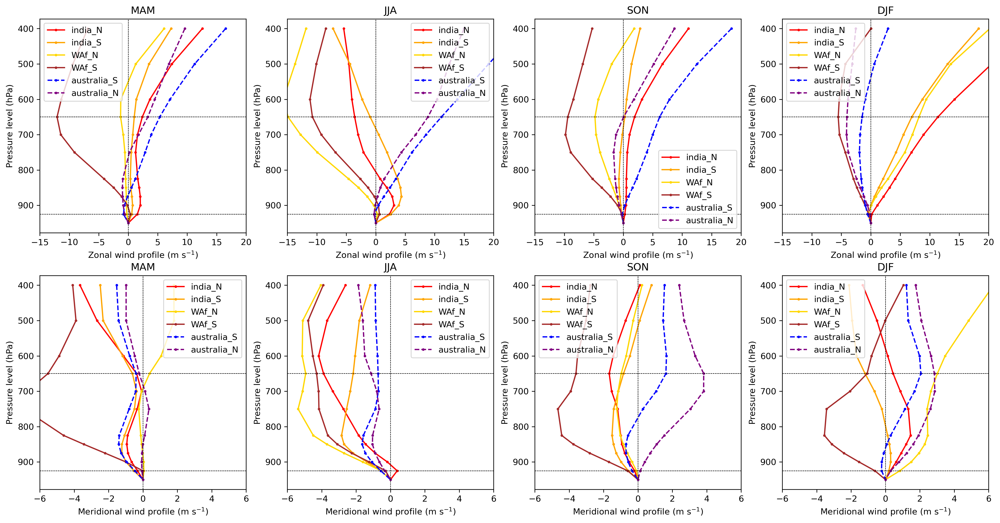

In [36]:
f = plt.figure(figsize=(20,10), dpi=300)

colors = ['red', 'orange', 'gold', 'brown', 'blue', 'purple']
lss = ['solid', 'solid', 'solid', 'solid', 'dashed', 'dashed']


for idx, seas in enumerate(['MAM', 'JJA', 'SON', 'DJF']):
    
    ax = f.add_subplot(2,4,idx+1)
    
    for ids, reg in enumerate(list(MREGIONS.keys())[4:10]):
   
            box = MREGIONS[reg][6]

            era_profile = era5u_mean.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1]), level=slice(350,950)).mean(['longitude','latitude']).squeeze()
         
            ax.plot(era_profile-era_profile[-1],era_profile.level, label=reg, marker='o', markersize=2, color = colors[ids], linestyle=lss[ids])
            ax.set_xlabel('Zonal wind profile (m s$^{-1}$)')
            ax.set_ylabel('Pressure level (hPa)')
            ax.set_xlim(-15,20)
            plt.title(seas)
            ax.axvline(0, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(925, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(650, linestyle='dashed', color='k', linewidth=0.5)
            
    ax.invert_yaxis()
    plt.legend()
for idx, seas in enumerate(['MAM', 'JJA', 'SON', 'DJF']):
    
    ax = f.add_subplot(2,4,idx+1+4)
    
    for ids, reg in enumerate(list(MREGIONS.keys())[4:10]):
   
            box = MREGIONS[reg][6]

            era_profile = era5v_mean.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1]), level=slice(350,950)).mean(['longitude','latitude']).squeeze()
         
            ax.plot(era_profile-era_profile[-1],era_profile.level, label=reg, marker='o', markersize=2, color = colors[ids], linestyle=lss[ids])
            ax.set_xlabel('Meridional wind profile (m s$^{-1}$)')
            ax.set_ylabel('Pressure level (hPa)')
            ax.set_xlim(-6,6)
            ax.axvline(0, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(925, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(650, linestyle='dashed', color='k', linewidth=0.5)
            
            plt.title(seas)
            
    ax.invert_yaxis()
    plt.legend()
plt.show()
f.savefig(cnst.FIGS+'/LMCS/ERA5_shear_profiles/MeanEasterlyMCS_ERA5wind_anomProfile.jpg')

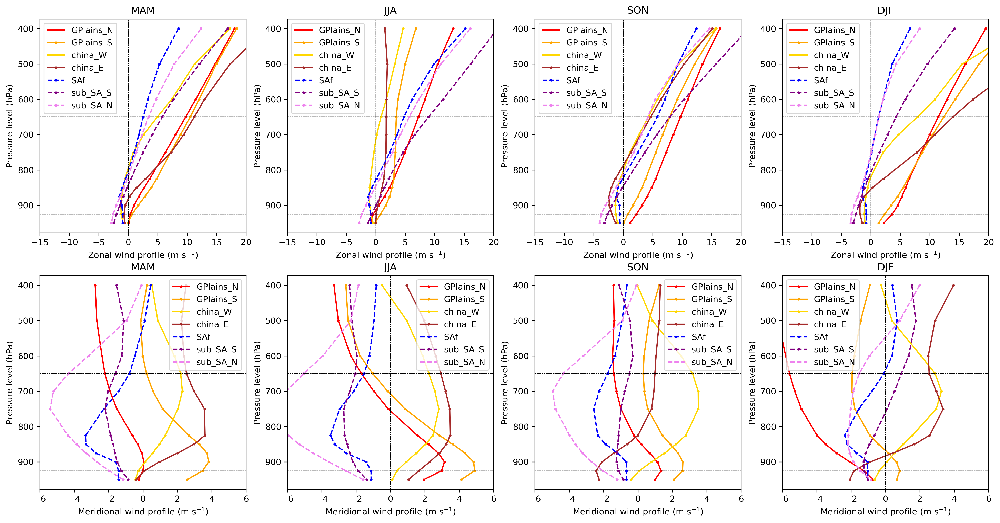

In [38]:
f = plt.figure(figsize=(20,10), dpi=300)


colors = ['red', 'orange', 'gold', 'brown', 'blue', 'purple', 'violet']
lss = ['solid', 'solid', 'solid', 'solid', 'dashed', 'dashed', 'dashed']

for idx, seas in enumerate(['MAM', 'JJA', 'SON', 'DJF']):
    
    ax = f.add_subplot(2,4,idx+1)
    
    for ids, reg in enumerate((list(MREGIONS.keys())[0:4])+(list(MREGIONS.keys())[10:13])):
   
            box = MREGIONS[reg][6]

            era_profile = era5u_mean.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1]), level=slice(350,950)).mean(['longitude','latitude']).squeeze()
         
            ax.plot(era_profile,era_profile.level, label=reg, marker='o', markersize=2, color = colors[ids], linestyle=lss[ids])
            ax.set_xlabel('Zonal wind profile (m s$^{-1}$)')
            ax.set_ylabel('Pressure level (hPa)')
            ax.set_xlim(-15,20)
            plt.title(seas)
            ax.axvline(0, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(925, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(650, linestyle='dashed', color='k', linewidth=0.5)
            
    ax.invert_yaxis()
    plt.legend()
for idx, seas in enumerate(['MAM', 'JJA', 'SON', 'DJF']):
    
    ax = f.add_subplot(2,4,idx+1+4)
    
    for ids, reg in enumerate((list(MREGIONS.keys())[0:4])+(list(MREGIONS.keys())[10:13])):
   
            box = MREGIONS[reg][6]

            era_profile = era5v_mean.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1]), level=slice(350,950)).mean(['longitude','latitude']).squeeze()
         
            ax.plot(era_profile,era_profile.level, label=reg, marker='o', markersize=2, color = colors[ids], linestyle=lss[ids])
            ax.set_xlabel('Meridional wind profile (m s$^{-1}$)')
            ax.set_ylabel('Pressure level (hPa)')
            ax.set_xlim(-6,6)
            ax.axvline(0, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(925, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(650, linestyle='dashed', color='k', linewidth=0.5)
            
            plt.title(seas)
            
    ax.invert_yaxis()
    plt.legend()
plt.show()
f.savefig(cnst.FIGS+'/LMCS/ERA5_shear_profiles/MeanWesterlyMCS_ERA5wind_absProfile.jpg')

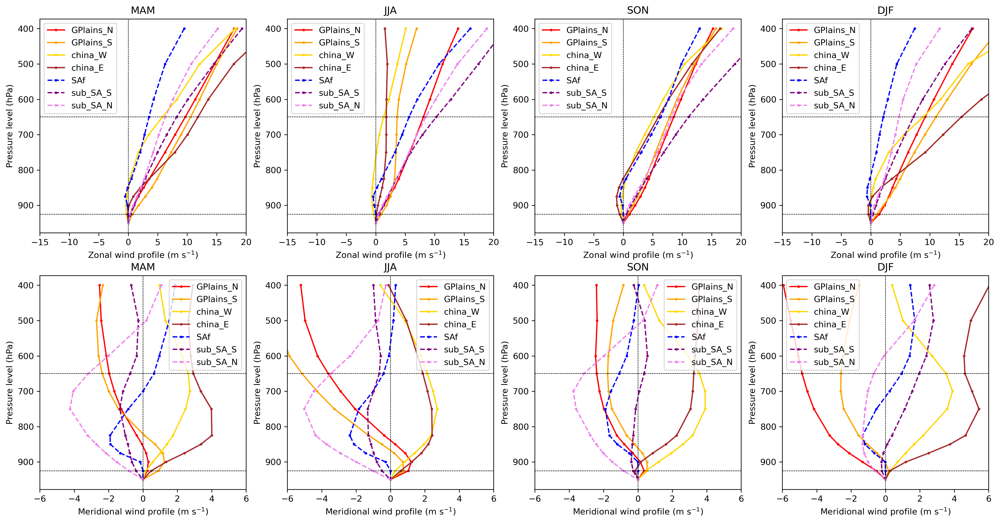

In [40]:
f = plt.figure(figsize=(20,10), dpi=300)

for idx, seas in enumerate(['MAM', 'JJA', 'SON', 'DJF']):
    
    ax = f.add_subplot(2,4,idx+1)
    
    for ids, reg in enumerate((list(MREGIONS.keys())[0:4])+(list(MREGIONS.keys())[10:13])):
   
            box = MREGIONS[reg][6]

            era_profile = era5u_mean.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1]), level=slice(350,950)).mean(['longitude','latitude']).squeeze()
         
            ax.plot(era_profile-era_profile[-1],era_profile.level, label=reg, marker='o', markersize=2, color = colors[ids], linestyle=lss[ids])
            ax.set_xlabel('Zonal wind profile (m s$^{-1}$)')
            ax.set_ylabel('Pressure level (hPa)')
            ax.set_xlim(-15,20)
            plt.title(seas)
            ax.axvline(0, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(925, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(650, linestyle='dashed', color='k', linewidth=0.5)
            
    ax.invert_yaxis()
    plt.legend()
for idx, seas in enumerate(['MAM', 'JJA', 'SON', 'DJF']):
    
    ax = f.add_subplot(2,4,idx+1+4)
    
    for ids, reg in enumerate((list(MREGIONS.keys())[0:4])+(list(MREGIONS.keys())[10:13])):
   
            box = MREGIONS[reg][6]

            era_profile = era5v_mean.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1]), level=slice(350,950)).mean(['longitude','latitude']).squeeze()
         
            ax.plot(era_profile-era_profile[-1],era_profile.level, label=reg, marker='o', markersize=2, color = colors[ids], linestyle=lss[ids])
            ax.set_xlabel('Meridional wind profile (m s$^{-1}$)')
            ax.set_ylabel('Pressure level (hPa)')
            ax.set_xlim(-6,6)
            ax.axvline(0, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(925, linestyle='dashed', color='k', linewidth=0.5)
            ax.axhline(650, linestyle='dashed', color='k', linewidth=0.5)
            
            plt.title(seas)
            
    ax.invert_yaxis()
    plt.legend()
plt.show()
f.savefig(cnst.FIGS+'/LMCS/ERA5_shear_profiles/MeanWesterlyMCS_ERA5wind_anomProfile.jpg')

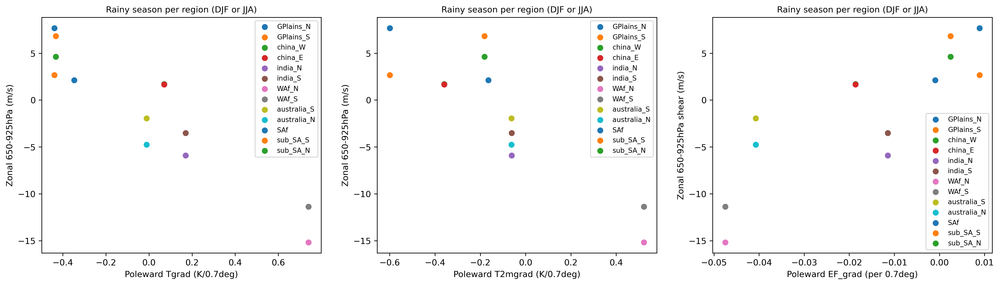

In [117]:
f = plt.figure(figsize=(20,5), dpi=300)


colors = ['red', 'orange', 'gold', 'brown', 'blue', 'purple', 'violet']
lss = ['solid', 'solid', 'solid', 'solid', 'dashed', 'dashed', 'dashed']

# for idx, seas in enumerate(['MAM', 'JJA', 'SON', 'DJF']):

tgrad_list = []
shear_list = []

ax = f.add_subplot(131)
for ids, reg in enumerate((list(MREGIONS.keys()))):
    
        

        seas = MREGIONS[reg][8]

        box = MREGIONS[reg][6]
        lbox = MREGIONS[reg][0]

        erashear_box = era_ushear.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1])).mean(['longitude','latitude']).squeeze()
        erat_poly = era_t.sel(season=seas, latitude=slice(lbox[2],lbox[3]), longitude=slice(lbox[0],lbox[1])).mean(['longitude']).squeeze().polyfit(dim='latitude', deg=1)
        
        if ids >= 8:
            erat_poly = erat_poly*-1

#         if ids >= 8:
#             erashear_box = erashear_box*-1
        
        ax.scatter(erat_poly['polyfit_coefficients'][0], erashear_box, label=reg)
        plt.title('Rainy season per region (DJF or JJA)', fontsize=10)
        ax.set_xlabel('Poleward Tgrad (K/0.7deg)')
        ax.set_ylabel('Zonal 650-925hPa (m/s)')
        ax.axhline(0, color='k', linestyle='dashed')
        ax.axvline(0, color='k', linestyle='dashed')
ax.legend(fontsize=8)    

#         tgrad_list.append(erat_poly['polyfit_coefficients'][0].values)
#         shear_list.append(erashear_box.values)
# stats.linregress(tgrad_list, shear_list)


ax = f.add_subplot(132)
for ids, reg in enumerate((list(MREGIONS.keys()))):
    
        

        seas = MREGIONS[reg][8]

        box = MREGIONS[reg][6]
        lbox = MREGIONS[reg][0]

        erashear_box = era_ushear.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1])).mean(['longitude','latitude']).squeeze()
        erat_poly = t2.sel(season=seas, latitude=slice(lbox[2],lbox[3]), longitude=slice(lbox[0],lbox[1])).mean(['longitude']).squeeze().polyfit(dim='latitude', deg=1)
        
        if ids >= 8:
            erat_poly = erat_poly*-1
#         if ids >= 8:
#             erashear_box = erashear_box*-1
        
        ax.scatter(erat_poly['polyfit_coefficients'][0], erashear_box, label=reg)
        plt.title('Rainy season per region (DJF or JJA)', fontsize=10)
        ax.set_xlabel('Poleward T2mgrad (K/0.7deg)')
        ax.set_ylabel('Zonal 650-925hPa (m/s)')
        ax.axhline(0, color='k', linestyle='dashed')
        ax.axvline(0, color='k', linestyle='dashed')
ax.legend(fontsize=8)    


ax = f.add_subplot(133)
for ids, reg in enumerate((list(MREGIONS.keys()))):
    
        

        seas = MREGIONS[reg][8]

        box = MREGIONS[reg][6]
        lbox = MREGIONS[reg][0]

        erashear_box = era_ushear.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1])).mean(['longitude','latitude']).squeeze()
        era_shbox = sh.sel(season=seas, latitude=slice(lbox[2],lbox[3]), longitude=slice(lbox[0],lbox[1])).mean(['longitude']).squeeze()*-1/3600     #.polyfit(dim='latitude', deg=1)
        era_lhbox = lh.sel(season=seas, latitude=slice(lbox[2],lbox[3]), longitude=slice(lbox[0],lbox[1])).mean(['longitude']).squeeze()*-1/3600
        
        erat_poly = (era_lhbox/(era_lhbox+era_shbox)).polyfit(dim='latitude', deg=1)
        
        #ipdb.set_trace()
        
        if ids >= 8:
            erat_poly = erat_poly*-1
            
#         if ids >= 8:
#             erashear_box = erashear_box*-1
        
        ax.scatter(erat_poly['polyfit_coefficients'][0], erashear_box, label=reg)
        plt.title('Rainy season per region (DJF or JJA)', fontsize=10)
        ax.set_xlabel('Poleward EF_grad (per 0.7deg)')
        ax.set_ylabel('Zonal 650-925hPa shear (m/s)')
        ax.axhline(0)
        ax.axvline(0)
ax.legend(fontsize=8)  


f.savefig(cnst.FIGS+'/LMCS/ERA5_shear_profiles/shear_Tgradient_relationship_climMean.jpg')

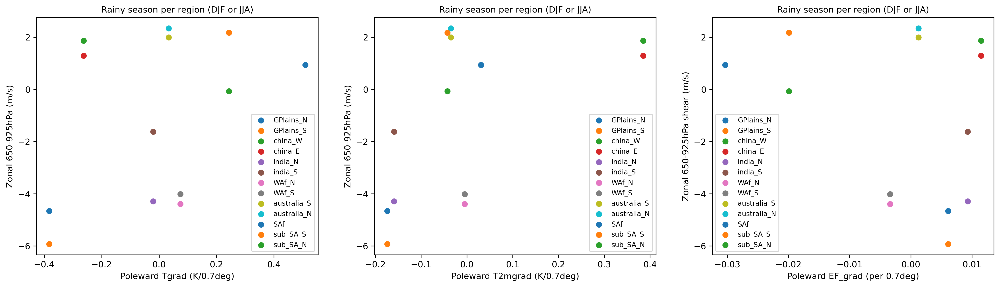

In [118]:
f = plt.figure(figsize=(20,5), dpi=300)


colors = ['red', 'orange', 'gold', 'brown', 'blue', 'purple', 'violet']
lss = ['solid', 'solid', 'solid', 'solid', 'dashed', 'dashed', 'dashed']

# for idx, seas in enumerate(['MAM', 'JJA', 'SON', 'DJF']):

tgrad_list = []
shear_list = []

ax = f.add_subplot(131)
for ids, reg in enumerate((list(MREGIONS.keys()))):
    
        

        seas = MREGIONS[reg][8]

        box = MREGIONS[reg][6]
        lbox = MREGIONS[reg][0]

        erashear_box = era_vshear.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1])).mean(['longitude','latitude']).squeeze()
        erat_poly = era_t.sel(season=seas, latitude=slice(lbox[2],lbox[3]), longitude=slice(lbox[0],lbox[1])).mean(['latitude']).squeeze().polyfit(dim='longitude', deg=1)
        
        if ids >= 8:
            erat_poly = erat_poly*-1

#         if ids >= 8:
#             erashear_box = erashear_box*-1
        
        ax.scatter(erat_poly['polyfit_coefficients'][0], erashear_box, label=reg)
        plt.title('Rainy season per region (DJF or JJA)', fontsize=10)
        ax.set_xlabel('Poleward Tgrad (K/0.7deg)')
        ax.set_ylabel('Zonal 650-925hPa (m/s)')
ax.legend(fontsize=8)    

#         tgrad_list.append(erat_poly['polyfit_coefficients'][0].values)
#         shear_list.append(erashear_box.values)
# stats.linregress(tgrad_list, shear_list)


ax = f.add_subplot(132)
for ids, reg in enumerate((list(MREGIONS.keys()))):
    
        

        seas = MREGIONS[reg][8]

        box = MREGIONS[reg][6]
        lbox = MREGIONS[reg][0]

        erashear_box = era_vshear.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1])).mean(['longitude','latitude']).squeeze()
        erat_poly = t2.sel(season=seas, latitude=slice(lbox[2],lbox[3]), longitude=slice(lbox[0],lbox[1])).mean(['latitude']).squeeze().polyfit(dim='longitude', deg=1)
        
        if ids >= 8:
            erat_poly = erat_poly*-1
#         if ids >= 8:
#             erashear_box = erashear_box*-1
        
        ax.scatter(erat_poly['polyfit_coefficients'][0], erashear_box, label=reg)
        plt.title('Rainy season per region (DJF or JJA)', fontsize=10)
        ax.set_xlabel('Poleward T2mgrad (K/0.7deg)')
        ax.set_ylabel('Zonal 650-925hPa (m/s)')
ax.legend(fontsize=8)    


ax = f.add_subplot(133)
for ids, reg in enumerate((list(MREGIONS.keys()))):
    
        

        seas = MREGIONS[reg][8]

        box = MREGIONS[reg][6]
        lbox = MREGIONS[reg][0]

        erashear_box = era_vshear.sel(season=seas, latitude=slice(box[2],box[3]), longitude=slice(box[0],box[1])).mean(['longitude','latitude']).squeeze()
        era_shbox = sh.sel(season=seas, latitude=slice(lbox[2],lbox[3]), longitude=slice(lbox[0],lbox[1])).mean(['latitude']).squeeze()*-1/3600     #.polyfit(dim='latitude', deg=1)
        era_lhbox = lh.sel(season=seas, latitude=slice(lbox[2],lbox[3]), longitude=slice(lbox[0],lbox[1])).mean(['latitude']).squeeze()*-1/3600
        
        erat_poly = (era_lhbox/(era_lhbox+era_shbox)).polyfit(dim='longitude', deg=1)
        
        #ipdb.set_trace()
        
        if ids >= 8:
            erat_poly = erat_poly*-1
            
#         if ids >= 8:
#             erashear_box = erashear_box*-1
        
        ax.scatter(erat_poly['polyfit_coefficients'][0], erashear_box, label=reg)
        plt.title('Rainy season per region (DJF or JJA)', fontsize=10)
        ax.set_xlabel('Poleward EF_grad (per 0.7deg)')
        ax.set_ylabel('Zonal 650-925hPa shear (m/s)')
ax.legend(fontsize=8)  


#f.savefig(cnst.FIGS+'/LMCS/ERA5_shear_profiles/shear_Tgradient_relationship_climMean.jpg')

In [10]:
import matplotlib.patches as patches
def draw_map(ax, t, lat, lon, title='', levels=None, quiver=None, contour=None, clabel='', cmap='RdBu_r'):
   
    plt.contourf(lon, lat, t, transform=ccrs.PlateCarree(), cmap=cmap, levels=levels, extend='both')
    ax.coastlines()

    ## quiver list
    if quiver is not None:
        qu = ax.quiver(quiver['x'], quiver['y'], quiver['u'], quiver['v'],scale=quiver['scale'],width=0.0005, headwidth=7)
    
    
        ## additional contour on plot   
    if contour is not None:
        contours = ax.contour(contour['x'], contour['y'], contour['data'], levels=contour['levels'], colors='Turquoise', linewidths=0.5 )
        #plt.clabel(contours, inline=True, fontsize=7, fmt='%1.1f')
    
    # Gridlines
    xl = ax.gridlines(draw_labels=True);
    xl.top_labels = False
    xl.right_labels = False
    xl.xlines = False
    xl.ylines=False
    # Countries
    ax.add_feature(cartopy.feature.BORDERS, linestyle='--', color='grey');
    
    #rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=0.8,edgecolor='w',facecolor='none', zorder=99)
        
    #ax.add_patch(rect2)
    
    plt.title(title)
    cbar = plt.colorbar()
    cbar.set_label(clabel)

In [11]:
era_uh = era5f_pl['u'].sel(level=650).groupby('time.season').mean('time').load()
era_ul = era5f_pl['u'].sel(level=925).groupby('time.season').mean('time').load()
era_vh = era5f_pl['v'].sel(level=650).groupby('time.season').mean('time').load()
era_vl = era5f_pl['v'].sel(level=925).groupby('time.season').mean('time').load()
era_t = era5f_pl['t'].sel(level=925).groupby('time.season').mean('time').load()

era_ushear = era_uh-era_ul
era_vshear = era_vh-era_vl
era_shear = np.sqrt(era_ushear**2+era_vshear**2)

In [21]:
era_uhh = era5f_pl['u'].sel(level=400).groupby('time.season').mean('time').load()
era_vhh = era5f_pl['v'].sel(level=400).groupby('time.season').mean('time').load()

In [9]:
f = plt.figure(figsize=(20,10), dpi=300)


st=5
sarrow = 1
scale = 300
lon =era_shear.longitude
lat = era_shear.latitude
lon2d, lat2d = np.meshgrid(lon,lat)
xquiv = lon2d[sarrow::st, sarrow::st]
yquiv = lat2d[sarrow::st, sarrow::st]

mtag = 'DJF'
uu = era_ushear.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vshear.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

ax = f.add_subplot(221, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 650-925hPa shear', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)


mtag = 'MAM'
uu = era_ushear.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vshear.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

ax = f.add_subplot(222, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 650-925hPa shear', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)


mtag = 'JJA'
uu = era_ushear.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vshear.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

ax = f.add_subplot(223, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 650-925hPa shear', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)

mtag = 'SON'
uu = era_ushear.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vshear.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}


ax = f.add_subplot(224, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 650-925hPa shear', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)

plt.tight_layout()
#f.savefig(cnst.FIGS+'/LMCS/ERA5_shear_profiles/profileBoxes_shear_overview.pdf')

NameError: name 'era_shear' is not defined

<Figure size 6000x3000 with 0 Axes>

In [13]:
era5f_srfc = xr.open_mfdataset('/media/ck/LStorage/global_water/other/ERA5_global_0.7/monthly/surface/*.nc')
era5f_srfc = u_darrays.flip_lat(era5f_srfc)

OSError: no files to open

In [224]:
era5_sm = era5f_srfc['swvl1'].groupby('time.season').mean('time').load()
era5_sshf = era5f_srfc['sshf'].groupby('time.season').mean('time').load()
era5_slhf = era5f_srfc['slhf'].groupby('time.season').mean('time').load()

In [83]:


st=5
sarrow = 1
scale = 300
lon =era_shear.longitude
lat = era_shear.latitude
lon2d, lat2d = np.meshgrid(lon,lat)
xquiv = lon2d[sarrow::st, sarrow::st]
yquiv = lat2d[sarrow::st, sarrow::st]

mtag = 'DJF'
uu = era_ushear.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vshear.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

llevels = np.linspace(0,0.5,20)

#ipdb.set_trace()

ax = f.add_subplot(221, projection=ccrs.PlateCarree())
draw_map(ax, era5_sm.sel(season=mtag), era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 SM | 650-925hPa shear', levels=llevels, clabel=r'degC', cmap='jet_r',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)


mtag = 'MAM'
uu = era_ushear.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vshear.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(222, projection=ccrs.PlateCarree())
draw_map(ax, era5_sm.sel(season=mtag), era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 SM | 650-925hPa shear', levels=llevels, clabel=r'degC', cmap='jet_r',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)

mtag = 'JJA'
uu = era_ushear.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vshear.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(223, projection=ccrs.PlateCarree())
draw_map(ax, era5_sm.sel(season=mtag), era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 SM | 650-925hPa shear', levels=llevels, clabel=r'degC', cmap='jet_r',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)


mtag = 'SON'
uu = era_ushear.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vshear.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(224, projection=ccrs.PlateCarree())
draw_map(ax, era5_sm.sel(season=mtag), era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 SM | 650-925hPa shear', levels=llevels, clabel=r'degC', cmap='jet_r',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for mr in mregions:
            
            # Create a Rectangle patch
    mrr = mregions[mr]
    a = mrr[0][0]
    b = mrr[0][2]
    width = mrr[0][1]-a
    height = mrr[0][3]-b
    rect = patches.Rectangle((a, b), width, height, linewidth=2, edgecolor='fuchsia', facecolor='none', transform=ax.transData)
    
    
plt.tight_layout()
f.savefig('/home/ck/DIR/cornkle/figs/LMCS/CMIP_LS3MIP/ERA5_SM_shear.pdf')

NameError: name 'era5_sm' is not defined

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


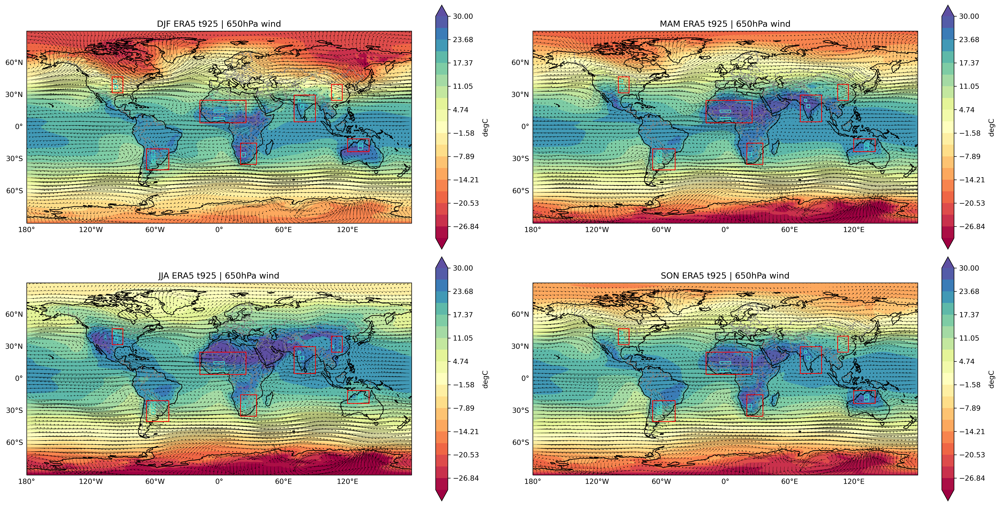

In [19]:
f = plt.figure(figsize=(20,10), dpi=300)


st=5
sarrow = 1
scale = 300
lon =era_shear.longitude
lat = era_shear.latitude
lon2d, lat2d = np.meshgrid(lon,lat)
xquiv = lon2d[sarrow::st, sarrow::st]
yquiv = lat2d[sarrow::st, sarrow::st]

mtag = 'DJF'
uu = era_uh.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vh.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(221, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 650hPa wind', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)

mtag = 'MAM'
uu = era_uh.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vh.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(222, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 650hPa wind', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)
    
    
mtag = 'JJA'
uu = era_uh.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vh.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(223, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 650hPa wind', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)

mtag = 'SON'
uu = era_uh.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vh.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(224, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 650hPa wind', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)


plt.tight_layout()
f.savefig(cnst.FIGS+'/LMCS/ERA5_shear_profiles/profileBoxes_650hPaWind_overview.pdf')

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


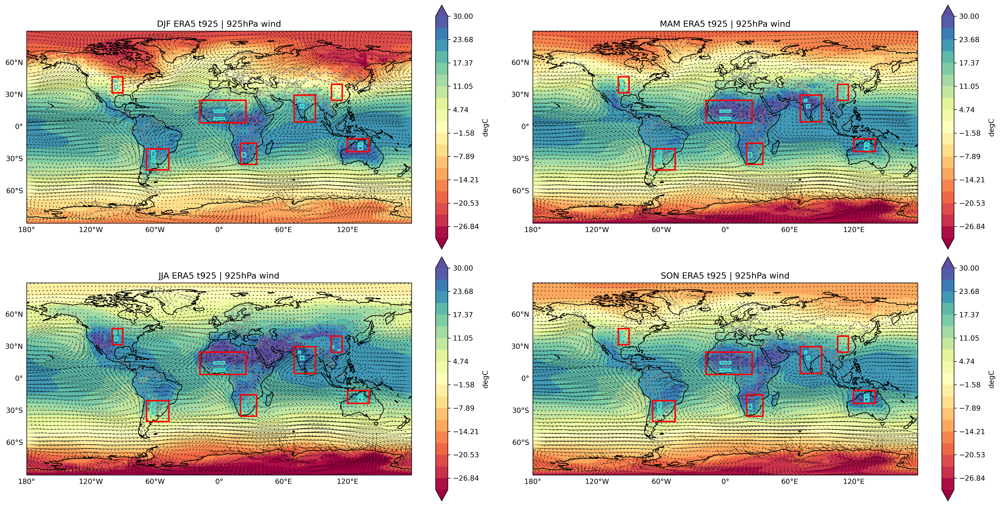

In [20]:
f = plt.figure(figsize=(20,10), dpi=300)


st=5
sarrow = 1
scale = 300
lon =era_shear.longitude
lat = era_shear.latitude
lon2d, lat2d = np.meshgrid(lon,lat)
xquiv = lon2d[sarrow::st, sarrow::st]
yquiv = lat2d[sarrow::st, sarrow::st]

mtag = 'DJF'
uu = era_ul.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vl.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(221, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 925hPa wind', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=2,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=2,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)

mtag = 'MAM'
uu = era_ul.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vl.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(222, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 925hPa wind', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=2,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=2,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)
    
    
mtag = 'JJA'
uu = era_ul.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vl.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(223, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 925hPa wind', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=2,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=2,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)

mtag = 'SON'
uu = era_ul.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vl.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(224, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 925hPa wind', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=2,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=2,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)


plt.tight_layout()
f.savefig(cnst.FIGS+'/LMCS/ERA5_shear_profiles/profileBoxes_925hPaWind_overview.pdf')

/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/home/ck/miniconda3/lib/python3.10/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


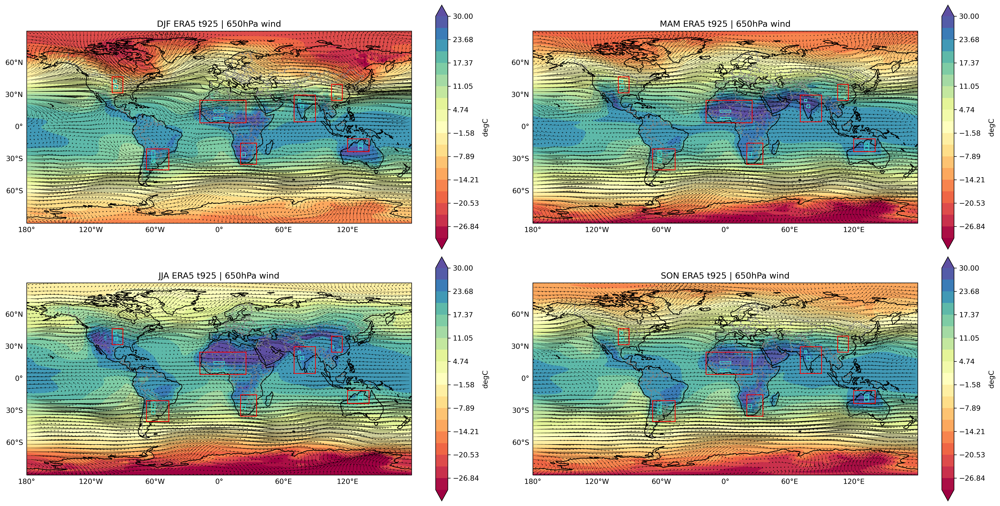

In [22]:
f = plt.figure(figsize=(20,10), dpi=300)


st=5
sarrow = 1
scale = 300
lon =era_shear.longitude
lat = era_shear.latitude
lon2d, lat2d = np.meshgrid(lon,lat)
xquiv = lon2d[sarrow::st, sarrow::st]
yquiv = lat2d[sarrow::st, sarrow::st]

mtag = 'DJF'
uu = era_uhh.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vhh.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(221, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 650hPa wind', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)

mtag = 'MAM'
uu = era_uhh.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vhh.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(222, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 650hPa wind', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)
    
    
mtag = 'JJA'
uu = era_uhh.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vhh.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(223, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 650hPa wind', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)

mtag = 'SON'
uu = era_uhh.sel(season=mtag)[sarrow::st, sarrow::st]
vv = era_vhh.sel(season=mtag)[sarrow::st, sarrow::st]
qin = {'x' : xquiv, 'y' : yquiv, 'u' : uu, 'v' : vv, 'scale' : scale}

#ipdb.set_trace()

ax = f.add_subplot(224, projection=ccrs.PlateCarree())
draw_map(ax, era_t.sel(season=mtag)-273.15, era_shear.latitude, era_shear.longitude, title=mtag+' ERA5 t925 | 650hPa wind', levels=np.linspace(-30,30,20), clabel=r'degC', cmap='Spectral',  quiver=qin) #np.percentile(k, np.arange(5,91,11)
for reg in MREGIONS.keys():
    box = MREGIONS[reg][6]
    rect2 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='turquoise', zorder=99, fill=False)
    ax.add_patch(rect2)
    box = MREGIONS[reg][0]
    rect1 = patches.Rectangle((box[0],box[2]),box[1]-box[0],box[3]-box[2],linewidth=1,edgecolor='red', zorder=99, fill=False)
    ax.add_patch(rect1)


plt.tight_layout()
f.savefig(cnst.FIGS+'/LMCS/ERA5_shear_profiles/profileBoxes_400hPaWind_overview.pdf')